# Annotate w1118_42D cells with cell type labels

In [1]:
!python --version

Python 3.12.2


## Load required packages 

In [2]:
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import torch
import scvi
import scarches as sca
from scarches.dataset.trvae.data_handling import remove_sparsity
from scipy.sparse import csr_matrix
from scipy.stats import median_abs_deviation
import seaborn as sns
from pathlib import Path
import matplotlib.pyplot as plt
import gdown
import copy as cp
import os


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
 captum (see https://github.com/pytorch/captum).


In [3]:
print(os.getenv("CUDA_VISIBLE_DEVICES"))
os.environ["CUDA_VISIBLE_DEVICES"]=os.getenv("CUDA_VISIBLE_DEVICES")

1


In [4]:
print(torch.cuda.is_available())
print(torch.cuda.device_count())
print(torch.cuda.current_device())
print(torch.cuda.device(0))
print(torch.cuda.get_device_name(0))

True
1
0
Tesla P100-PCIE-12GB


In [5]:
sns.set_style('white')
sns.set(font_scale=1.5)
sc.settings.set_figure_params(dpi=80, facecolor="white")
sc.logging.print_header()
sc.settings.verbosity = 3

scanpy==1.10.0 anndata==0.10.6 umap==0.5.5 numpy==1.26.4 scipy==1.12.0 pandas==2.2.1 scikit-learn==1.4.1.post1 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


## Read FCA reference data and query w1118_42d datasets

In [10]:

## Set up I/O directories
basepath = Path("/projectnb/mccall/sbandyadka/drpr42d_snrnaseq/")
inputpath = basepath.joinpath('analysis','preprocess')
referencepath = basepath.joinpath('reference','FCA')
outputpath = basepath.joinpath('analysis','scarches')


In [11]:
## Read sctk-qc h5ad 
w1118_42d = sc.read_h5ad(inputpath.joinpath("w1118_42d_slim.h5ad"))
w1118_42d.raw = w1118_42d

w1118_42d

AnnData object with n_obs × n_vars = 9033 × 16507
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'cell_barcode', 'column_name', 'sample', 'sum', 'detected', 'percent.top_50', 'percent.top_100', 'percent.top_200', 'percent.top_500', 'total', 'doubletFinder_doublet_score_resolution_1.5', 'doubletFinder_doublet_label_resolution_1.5', 'scds_cxds_score', 'scds_cxds_call', 'scds_bcds_score', 'scds_bcds_call', 'scds_hybrid_score', 'scds_hybrid_call', 'decontX_contamination', 'decontX_clusters', 'nCount_decontXcounts', 'nFeature_decontXcounts', 'nCount_RNA', 'nFeature_RNA', 'log1p_total_counts', 'log1p_n_genes_by_counts', 'percent.mt', 'nCount_outlier', 'nFeature_outlier', 'mt_outlier', 'originalexp_snn_res.0.5', 'seurat_clusters', 'soup_group', 'nCount_soupXcounts', 'nFeature_soupXcounts', 'nCount_SCT', 'nFeature_SCT', 'nCount_soupX_SCT', 'nFeature_soupX_SCT', 'nCount_decontX_SCT', 'nFeature_decontX_SCT', 'SCT_snn_res.0.02', 'SCT_snn_res.0.2', 'SCT_snn_res.0.8', 'SCT_snn

In [12]:
## Read reference h5ad 
fca_reference = sc.read_h5ad(referencepath.joinpath("v2_fca_biohub_head_10x_raw.h5ad"))
fca_reference


AnnData object with n_obs × n_vars = 100527 × 13056
    obs: 'age', 'batch', 'batch_id', 'celda_decontx__clusters', 'celda_decontx__contamination', 'celda_decontx__doublemad_predicted_outliers', 'dissection_lab', 'fca_id', 'fly_genetics', 'id', 'log_n_counts', 'log_n_genes', 'n_counts', 'n_genes', 'note', 'percent_mito', 'sample_id', 'scrublet__doublet_scores', 'scrublet__predicted_doublets', 'scrublet__predicted_doublets_based_on_10x_chromium_spec', 'sex', 'tissue', 'leiden_res0.4', 'leiden_res0.6', 'leiden_res0.8', 'leiden_res1.0', 'leiden_res1.2', 'leiden_res1.4', 'leiden_res1.6', 'leiden_res1.8', 'leiden_res10.0', 'leiden_res12.0', 'leiden_res14.0', 'leiden_res16.0', 'leiden_res18.0', 'leiden_res2.0', 'leiden_res20.0', 'leiden_res25.0', 'leiden_res4.0', 'leiden_res50.0', 'leiden_res6.0', 'leiden_res8.0', 'annotation', 'broad_annotation', 'broad_annotation_extrapolated'
    obsm: 'X_pca', 'X_tsne', 'X_umap'

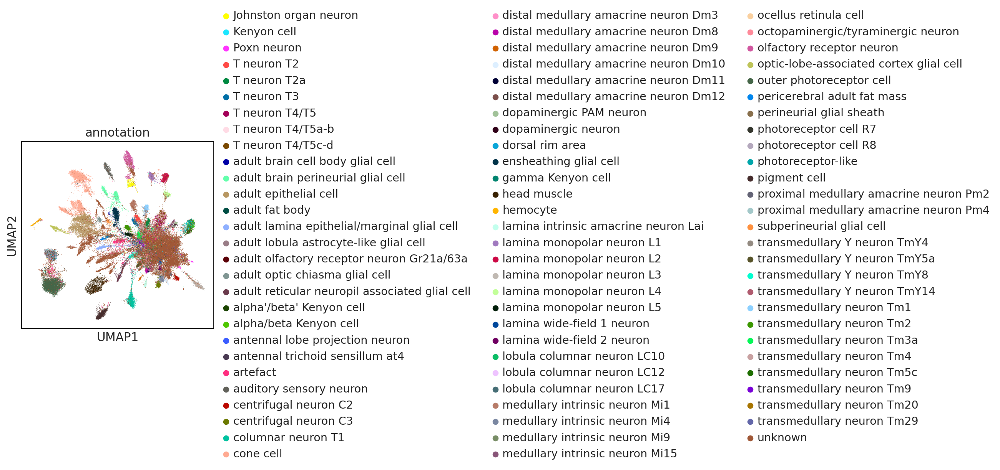

In [13]:
sc.pl.umap(fca_reference,color="annotation")

In [14]:
fca_reference.raw = fca_reference
sc.pp.normalize_total(fca_reference)
sc.pp.log1p(fca_reference)


normalizing counts per cell
    finished (0:00:00)


In [15]:
fca_reference.obs[:5]

,age,batch,batch_id,celda_decontx__clusters,celda_decontx__contamination,celda_decontx__doublemad_predicted_outliers,dissection_lab,fca_id,fly_genetics,id,...,leiden_res2.0,leiden_res20.0,leiden_res25.0,leiden_res4.0,leiden_res50.0,leiden_res6.0,leiden_res8.0,annotation,broad_annotation,broad_annotation_extrapolated
index,,,,,,,,,,,,,,,,,,,,,
AAACCCAGTTACGGAG-d541ae4e__FCA1_MaleFemale_Head,5,0,1,1,0.057744,False,Liqun Luo,FCA1,yw; UAS-UNC84GFP,d541ae4e__FCA1_MaleFemale_Head,...,12,25,18,39,19,27,44,unknown,unknown,unknown
AAACCCATCCGTACGG-d541ae4e__FCA1_MaleFemale_Head,5,0,1,1,0.066588,False,Liqun Luo,FCA1,yw; UAS-UNC84GFP,d541ae4e__FCA1_MaleFemale_Head,...,3,240,222,24,485,24,28,unknown,unknown,unknown
AAACGAAGTATGATCC-d541ae4e__FCA1_MaleFemale_Head,5,0,1,1,0.182339,False,Liqun Luo,FCA1,yw; UAS-UNC84GFP,d541ae4e__FCA1_MaleFemale_Head,...,38,170,165,67,131,80,91,lamina wide-field 2 neuron,neuron,neuron
AAACGAATCACCTACC-d541ae4e__FCA1_MaleFemale_Head,5,0,1,1,0.587886,True,Liqun Luo,FCA1,yw; UAS-UNC84GFP,d541ae4e__FCA1_MaleFemale_Head,...,5,122,279,2,506,1,1,unknown,unknown,unknown
AAACGCTAGAAACCAT-d541ae4e__FCA1_MaleFemale_Head,5,0,1,3,0.152492,False,Liqun Luo,FCA1,yw; UAS-UNC84GFP,d541ae4e__FCA1_MaleFemale_Head,...,6,0,50,3,424,4,3,T neuron T4/T5,neuron,neuron


In [16]:
sc.pp.highly_variable_genes(
    fca_reference,
    n_top_genes=2000,
    batch_key="batch",
    subset=True)

extracting highly variable genes
    finished (0:00:40)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [17]:

common_genes = list(set(w1118_42d.var_names) & set(fca_reference.var_names))
len(common_genes)

fca_reference = fca_reference[:,common_genes ]
fca_reference = fca_reference.copy()
fca_reference

AnnData object with n_obs × n_vars = 100527 × 1982
    obs: 'age', 'batch', 'batch_id', 'celda_decontx__clusters', 'celda_decontx__contamination', 'celda_decontx__doublemad_predicted_outliers', 'dissection_lab', 'fca_id', 'fly_genetics', 'id', 'log_n_counts', 'log_n_genes', 'n_counts', 'n_genes', 'note', 'percent_mito', 'sample_id', 'scrublet__doublet_scores', 'scrublet__predicted_doublets', 'scrublet__predicted_doublets_based_on_10x_chromium_spec', 'sex', 'tissue', 'leiden_res0.4', 'leiden_res0.6', 'leiden_res0.8', 'leiden_res1.0', 'leiden_res1.2', 'leiden_res1.4', 'leiden_res1.6', 'leiden_res1.8', 'leiden_res10.0', 'leiden_res12.0', 'leiden_res14.0', 'leiden_res16.0', 'leiden_res18.0', 'leiden_res2.0', 'leiden_res20.0', 'leiden_res25.0', 'leiden_res4.0', 'leiden_res50.0', 'leiden_res6.0', 'leiden_res8.0', 'annotation', 'broad_annotation', 'broad_annotation_extrapolated'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variabl

In [18]:
sca.models.SCVI.setup_anndata(fca_reference, batch_key="batch")

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [19]:
vae = sca.models.SCVI(
    fca_reference,
    n_layers=2,
    encode_covariates=True,
    deeply_inject_covariates=True,
    use_layer_norm="both",
    use_batch_norm="none"
)

In [20]:
vae.train(max_epochs=100)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Epoch 1/100:   0%|          | 0/100 [00:00<?, ?it/s]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/100:   1%|          | 1/100 [00:11<19:31, 11.83s/it, v_num=1, train_loss_step=144, train_loss_epoch=157]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/100:   2%|▏         | 2/100 [00:19<15:40,  9.60s/it, v_num=1, train_loss_step=143, train_loss_epoch=146]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/100:   3%|▎         | 3/100 [00:27<14:23,  8.90s/it, v_num=1, train_loss_step=140, train_loss_epoch=142]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/100:   4%|▍         | 4/100 [00:35<13:40,  8.55s/it, v_num=1, train_loss_step=138, train_loss_epoch=140]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/100:   5%|▌         | 5/100 [00:43<13:13,  8.36s/it, v_num=1, train_loss_step=136, train_loss_epoch=139]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/100:   6%|▌         | 6/100 [00:52<12:55,  8.25s/it, v_num=1, train_loss_step=138, train_loss_epoch=138]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/100:   7%|▋         | 7/100 [01:00<12:39,  8.17s/it, v_num=1, train_loss_step=133, train_loss_epoch=137]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/100:   8%|▊         | 8/100 [01:08<12:27,  8.12s/it, v_num=1, train_loss_step=138, train_loss_epoch=137]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/100:   9%|▉         | 9/100 [01:16<12:18,  8.11s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/100:  10%|█         | 10/100 [01:24<12:07,  8.09s/it, v_num=1, train_loss_step=133, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/100:  11%|█         | 11/100 [01:32<11:58,  8.08s/it, v_num=1, train_loss_step=136, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/100:  12%|█▏        | 12/100 [01:40<11:50,  8.08s/it, v_num=1, train_loss_step=132, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/100:  13%|█▎        | 13/100 [01:48<11:42,  8.08s/it, v_num=1, train_loss_step=133, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/100:  14%|█▍        | 14/100 [01:56<11:34,  8.08s/it, v_num=1, train_loss_step=134, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/100:  15%|█▌        | 15/100 [02:04<11:26,  8.07s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/100:  16%|█▌        | 16/100 [02:12<11:18,  8.08s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/100:  17%|█▋        | 17/100 [02:20<11:09,  8.07s/it, v_num=1, train_loss_step=138, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/100:  18%|█▊        | 18/100 [02:28<11:02,  8.08s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/100:  19%|█▉        | 19/100 [02:36<10:53,  8.07s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/100:  20%|██        | 20/100 [02:44<10:45,  8.07s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/100:  21%|██        | 21/100 [02:52<10:37,  8.07s/it, v_num=1, train_loss_step=138, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/100:  22%|██▏       | 22/100 [03:01<10:31,  8.09s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/100:  23%|██▎       | 23/100 [03:09<10:22,  8.08s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/100:  24%|██▍       | 24/100 [03:17<10:14,  8.09s/it, v_num=1, train_loss_step=135, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/100:  25%|██▌       | 25/100 [03:25<10:05,  8.07s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/100:  26%|██▌       | 26/100 [03:33<09:57,  8.08s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/100:  27%|██▋       | 27/100 [03:41<09:48,  8.06s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/100:  28%|██▊       | 28/100 [03:49<09:40,  8.07s/it, v_num=1, train_loss_step=135, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/100:  29%|██▉       | 29/100 [03:57<09:32,  8.06s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/100:  30%|███       | 30/100 [04:05<09:24,  8.06s/it, v_num=1, train_loss_step=131, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/100:  31%|███       | 31/100 [04:13<09:15,  8.05s/it, v_num=1, train_loss_step=138, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/100:  32%|███▏      | 32/100 [04:21<09:07,  8.06s/it, v_num=1, train_loss_step=133, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 34/100:  33%|███▎      | 33/100 [04:29<08:59,  8.05s/it, v_num=1, train_loss_step=135, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 35/100:  34%|███▍      | 34/100 [04:37<08:51,  8.06s/it, v_num=1, train_loss_step=135, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 36/100:  35%|███▌      | 35/100 [04:45<08:43,  8.05s/it, v_num=1, train_loss_step=133, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 37/100:  36%|███▌      | 36/100 [04:53<08:36,  8.06s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 38/100:  37%|███▋      | 37/100 [05:01<08:27,  8.06s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 39/100:  38%|███▊      | 38/100 [05:10<08:20,  8.07s/it, v_num=1, train_loss_step=132, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 40/100:  39%|███▉      | 39/100 [05:18<08:11,  8.06s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 41/100:  40%|████      | 40/100 [05:26<08:04,  8.08s/it, v_num=1, train_loss_step=133, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 42/100:  41%|████      | 41/100 [05:34<07:56,  8.07s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 43/100:  42%|████▏     | 42/100 [05:42<07:48,  8.08s/it, v_num=1, train_loss_step=141, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 44/100:  43%|████▎     | 43/100 [05:50<07:40,  8.07s/it, v_num=1, train_loss_step=138, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 45/100:  44%|████▍     | 44/100 [05:58<07:32,  8.08s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 46/100:  45%|████▌     | 45/100 [06:06<07:23,  8.07s/it, v_num=1, train_loss_step=138, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 47/100:  46%|████▌     | 46/100 [06:14<07:15,  8.07s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 48/100:  47%|████▋     | 47/100 [06:22<07:07,  8.06s/it, v_num=1, train_loss_step=131, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 49/100:  48%|████▊     | 48/100 [06:30<06:59,  8.06s/it, v_num=1, train_loss_step=139, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/100:  49%|████▉     | 49/100 [06:38<06:50,  8.05s/it, v_num=1, train_loss_step=135, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 51/100:  50%|█████     | 50/100 [06:46<06:43,  8.07s/it, v_num=1, train_loss_step=136, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 52/100:  51%|█████     | 51/100 [06:54<06:34,  8.06s/it, v_num=1, train_loss_step=139, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 53/100:  52%|█████▏    | 52/100 [07:03<06:27,  8.07s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 54/100:  53%|█████▎    | 53/100 [07:11<06:18,  8.06s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 55/100:  54%|█████▍    | 54/100 [07:19<06:11,  8.07s/it, v_num=1, train_loss_step=134, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 56/100:  55%|█████▌    | 55/100 [07:27<06:02,  8.06s/it, v_num=1, train_loss_step=133, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 57/100:  56%|█████▌    | 56/100 [07:35<05:54,  8.07s/it, v_num=1, train_loss_step=135, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 58/100:  57%|█████▋    | 57/100 [07:43<05:46,  8.05s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 59/100:  58%|█████▊    | 58/100 [07:51<05:38,  8.06s/it, v_num=1, train_loss_step=137, train_loss_epoch=135]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 60/100:  59%|█████▉    | 59/100 [07:59<05:30,  8.05s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 61/100:  60%|██████    | 60/100 [08:07<05:22,  8.05s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 62/100:  61%|██████    | 61/100 [08:15<05:13,  8.04s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 63/100:  62%|██████▏   | 62/100 [08:23<05:05,  8.05s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 64/100:  63%|██████▎   | 63/100 [08:31<04:57,  8.04s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 65/100:  64%|██████▍   | 64/100 [08:39<04:49,  8.05s/it, v_num=1, train_loss_step=136, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 66/100:  65%|██████▌   | 65/100 [08:47<04:41,  8.04s/it, v_num=1, train_loss_step=133, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 67/100:  66%|██████▌   | 66/100 [08:55<04:33,  8.05s/it, v_num=1, train_loss_step=141, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 68/100:  67%|██████▋   | 67/100 [09:03<04:25,  8.05s/it, v_num=1, train_loss_step=134, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 69/100:  68%|██████▊   | 68/100 [09:11<04:17,  8.06s/it, v_num=1, train_loss_step=132, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 70/100:  69%|██████▉   | 69/100 [09:19<04:09,  8.05s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 71/100:  70%|███████   | 70/100 [09:27<04:01,  8.06s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 72/100:  71%|███████   | 71/100 [09:36<03:53,  8.06s/it, v_num=1, train_loss_step=134, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 73/100:  72%|███████▏  | 72/100 [09:44<03:46,  8.07s/it, v_num=1, train_loss_step=139, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 74/100:  73%|███████▎  | 73/100 [09:52<03:37,  8.07s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 75/100:  74%|███████▍  | 74/100 [10:00<03:29,  8.07s/it, v_num=1, train_loss_step=133, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 76/100:  75%|███████▌  | 75/100 [10:08<03:21,  8.06s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 77/100:  76%|███████▌  | 76/100 [10:16<03:13,  8.07s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 78/100:  77%|███████▋  | 77/100 [10:24<03:05,  8.06s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 79/100:  78%|███████▊  | 78/100 [10:32<02:57,  8.07s/it, v_num=1, train_loss_step=134, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 80/100:  79%|███████▉  | 79/100 [10:40<02:49,  8.06s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 81/100:  80%|████████  | 80/100 [10:48<02:41,  8.07s/it, v_num=1, train_loss_step=140, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 82/100:  81%|████████  | 81/100 [10:56<02:33,  8.07s/it, v_num=1, train_loss_step=139, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 83/100:  82%|████████▏ | 82/100 [11:04<02:25,  8.08s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 84/100:  83%|████████▎ | 83/100 [11:12<02:17,  8.07s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 85/100:  84%|████████▍ | 84/100 [11:20<02:09,  8.08s/it, v_num=1, train_loss_step=133, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 86/100:  85%|████████▌ | 85/100 [11:28<02:00,  8.06s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 87/100:  86%|████████▌ | 86/100 [11:37<01:52,  8.05s/it, v_num=1, train_loss_step=139, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 88/100:  87%|████████▋ | 87/100 [11:45<01:44,  8.05s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 89/100:  88%|████████▊ | 88/100 [11:53<01:36,  8.05s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 90/100:  89%|████████▉ | 89/100 [12:01<01:28,  8.02s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 91/100:  90%|█████████ | 90/100 [12:09<01:20,  8.03s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 92/100:  91%|█████████ | 91/100 [12:17<01:12,  8.03s/it, v_num=1, train_loss_step=138, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 93/100:  92%|█████████▏| 92/100 [12:25<01:04,  8.03s/it, v_num=1, train_loss_step=137, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 94/100:  93%|█████████▎| 93/100 [12:33<00:56,  8.03s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 95/100:  94%|█████████▍| 94/100 [12:41<00:48,  8.04s/it, v_num=1, train_loss_step=134, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 96/100:  95%|█████████▌| 95/100 [12:49<00:40,  8.04s/it, v_num=1, train_loss_step=135, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 97/100:  96%|█████████▌| 96/100 [12:57<00:32,  8.04s/it, v_num=1, train_loss_step=133, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 98/100:  97%|█████████▋| 97/100 [13:05<00:24,  8.03s/it, v_num=1, train_loss_step=136, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 99/100:  98%|█████████▊| 98/100 [13:13<00:16,  8.04s/it, v_num=1, train_loss_step=136, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 100/100:  99%|█████████▉| 99/100 [13:21<00:08,  8.03s/it, v_num=1, train_loss_step=139, train_loss_epoch=136]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 100/100: 100%|██████████| 100/100 [13:29<00:00,  8.03s/it, v_num=1, train_loss_step=136, train_loss_epoch=136]

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [13:29<00:00,  8.09s/it, v_num=1, train_loss_step=136, train_loss_epoch=136]


In [21]:
reference_latent = sc.AnnData(vae.get_latent_representation())
reference_latent.obs["batch"] = fca_reference.obs["batch"].tolist()
reference_latent.obs["annotation"] = fca_reference.obs["annotation"].tolist()
reference_latent.obs["broad_annotation"] = fca_reference.obs["broad_annotation"].tolist()
reference_latent.obs["broad_annotation_extrapolated"] = fca_reference.obs["broad_annotation_extrapolated"].tolist()

In [22]:
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)

computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:30)
running Leiden clustering


/scratch/6027565.1.onrcc-gpu-pub/ipykernel_3544346/1984373453.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(reference_latent)


    finished: found 32 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:36)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:26)


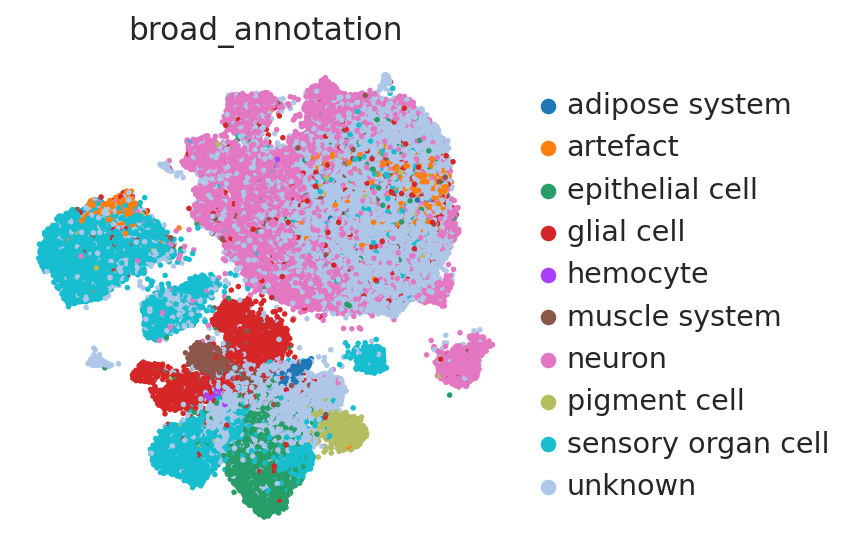

In [23]:
#reference_latent.obs['annotation'] = reference_latent.obs['annotation'].astype('category')
reference_latent.obs['broad_annotation'] = reference_latent.obs['broad_annotation'].astype('category')
#reference_latent.obs['broad_annotation_extrapolated'] = reference_latent.obs['broad_annotation_extrapolated'].astype('category')

sc.pl.umap(reference_latent,
           color=['broad_annotation'],
           frameon=False,
           wspace=0.6, s=25
           )

In [24]:
vae.save(outputpath, overwrite=True)
reference_latent.write(outputpath.joinpath('reference_latent.h5ad'))

In [25]:

#reference_latent = sc.read_h5ad(outputpath.joinpath("reference_latent.h5ad"))
#reference_latent

In [26]:
reference_latent.obs['broad_annotation_batch'] = np.char.add(np.char.add(np.array(reference_latent.obs['broad_annotation'], dtype= str), '-'),
                                             np.array(reference_latent.obs['batch'], dtype=str))
reference_latent.obs['annotation_batch'] = np.char.add(np.char.add(np.array(reference_latent.obs['annotation'], dtype= str), '-'),
                                             np.array(reference_latent.obs['batch'], dtype=str))

Starting tree:


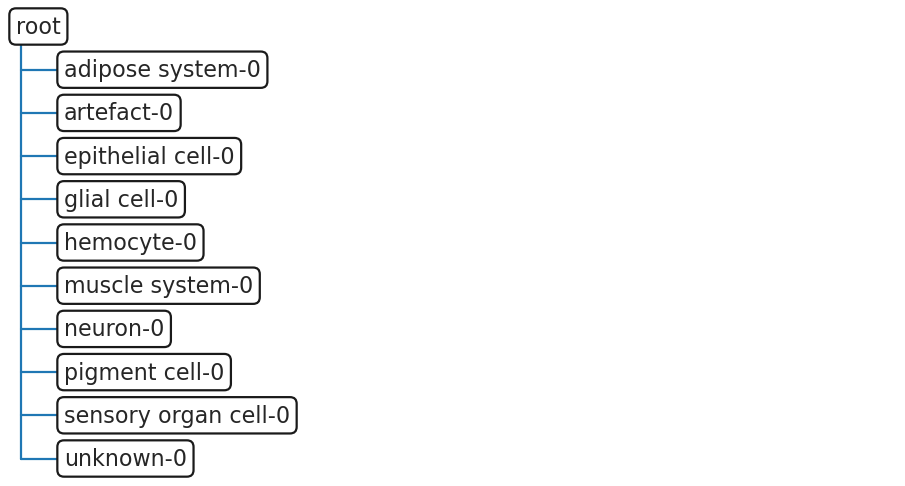


Adding dataset 1 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


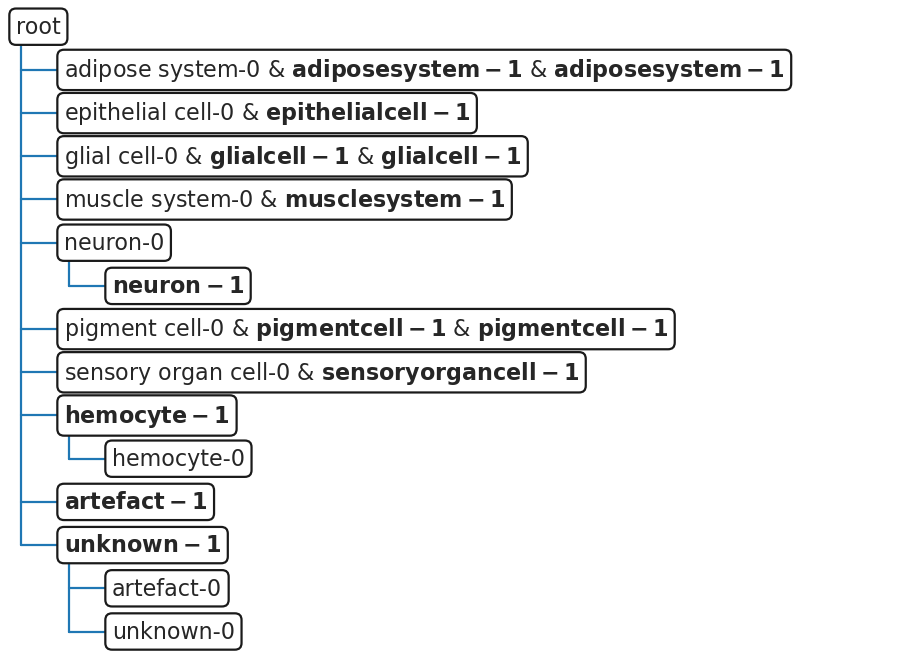


Adding dataset 2 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat

These populations are missing from the tree: 
['artefact-2' 'unknown-2']

Updated tree:


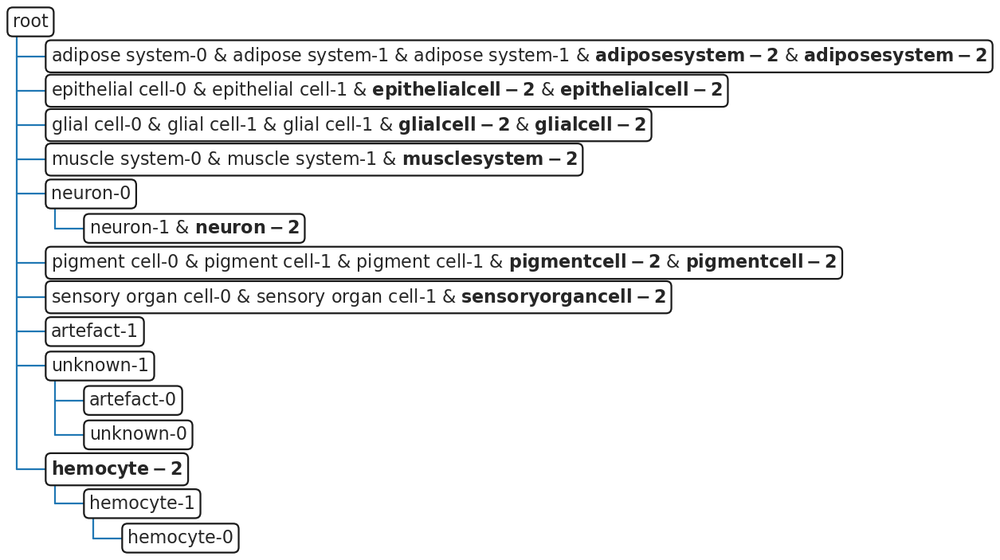


Adding dataset 3 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


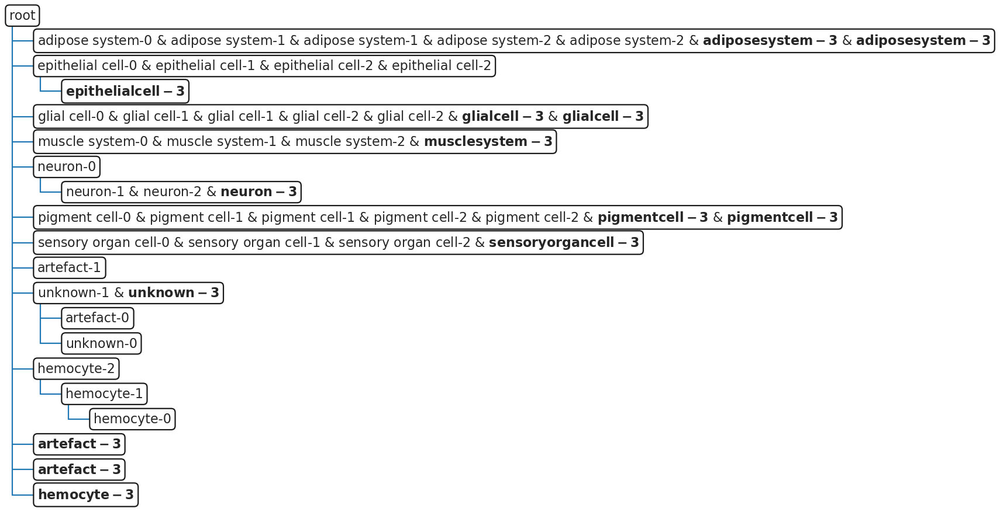


Adding dataset 4 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


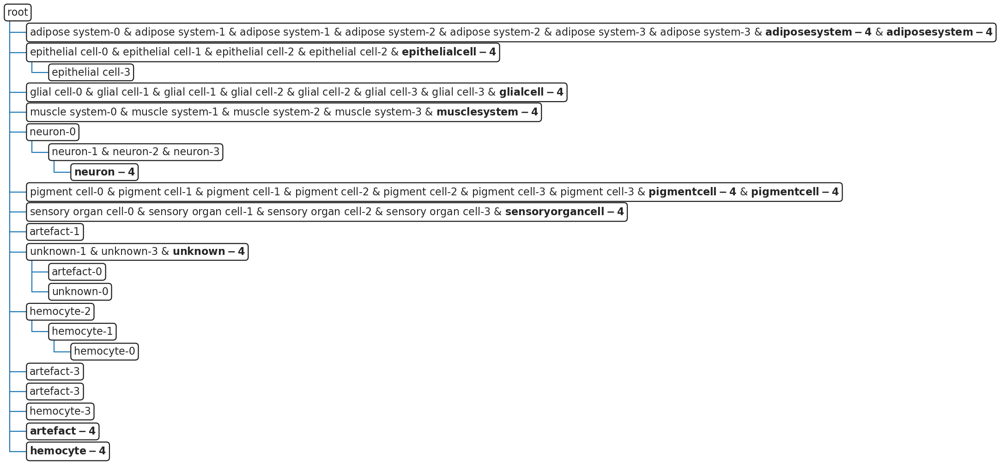


Adding dataset 5 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


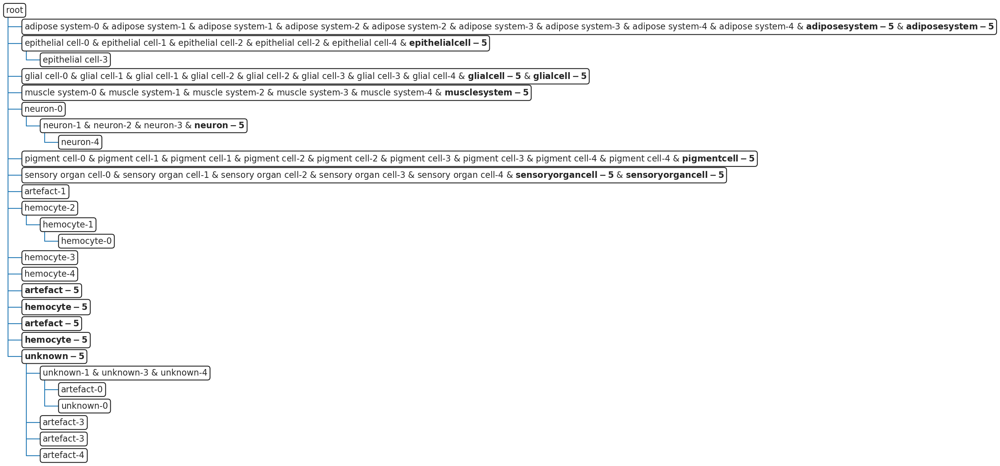


Adding dataset 6 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


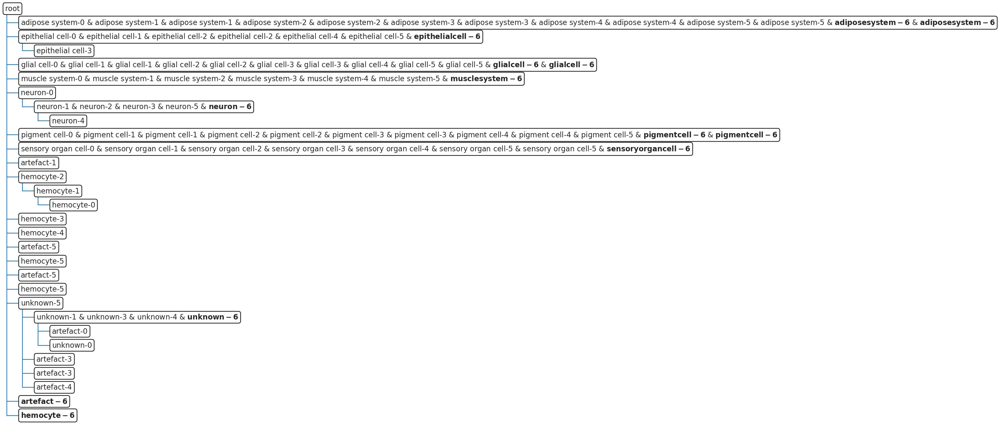


Adding dataset 7 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


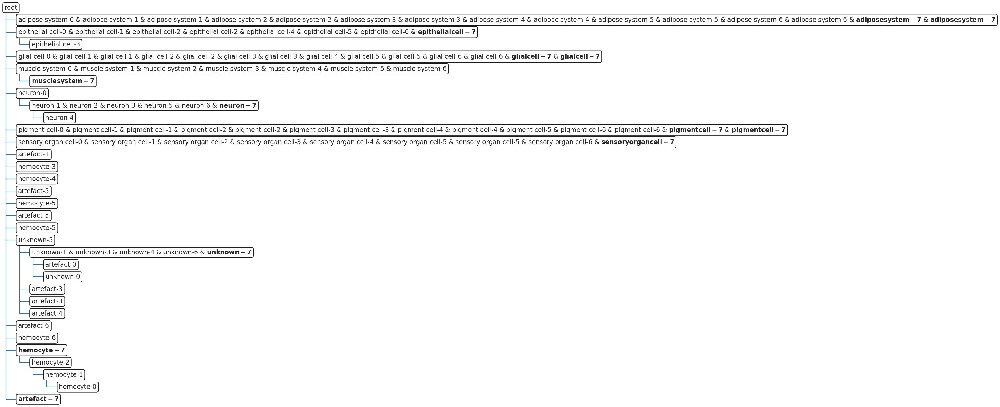


Adding dataset 8 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


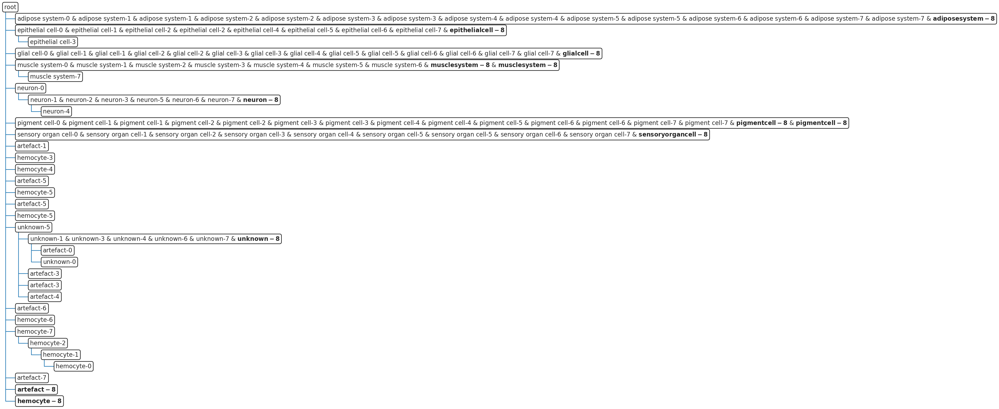


Adding dataset 9 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


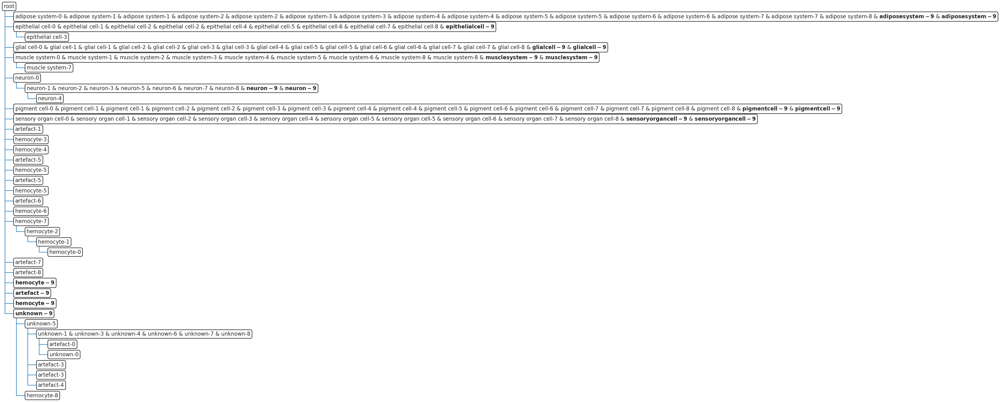


Adding dataset 10 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


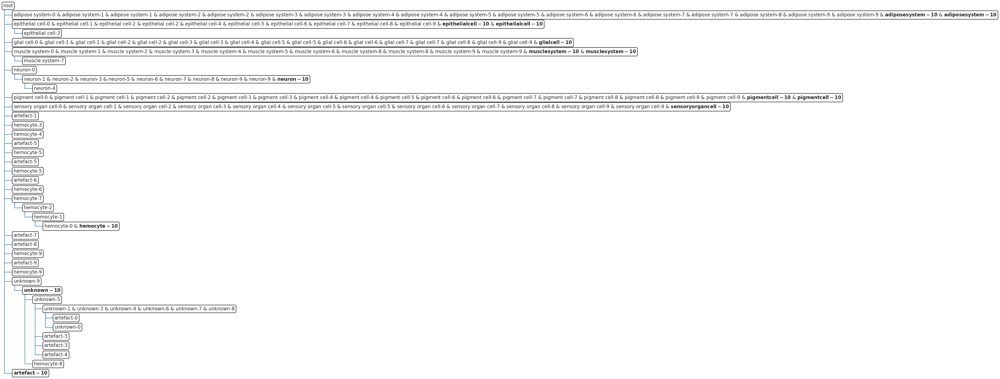


Adding dataset 11 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


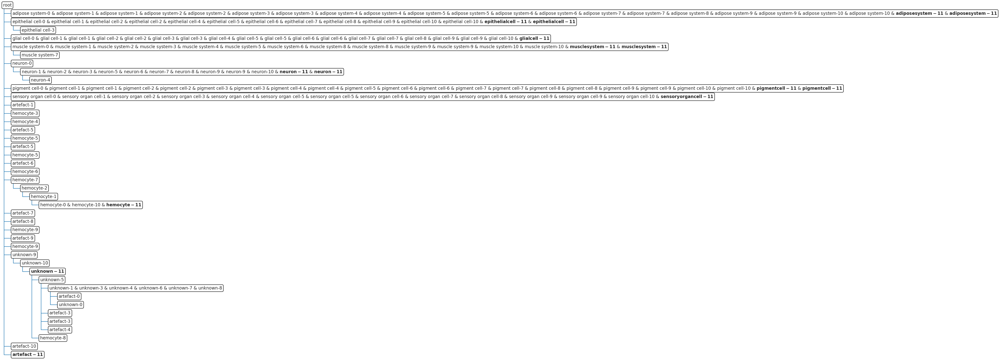


Adding dataset 12 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compat


Updated tree:


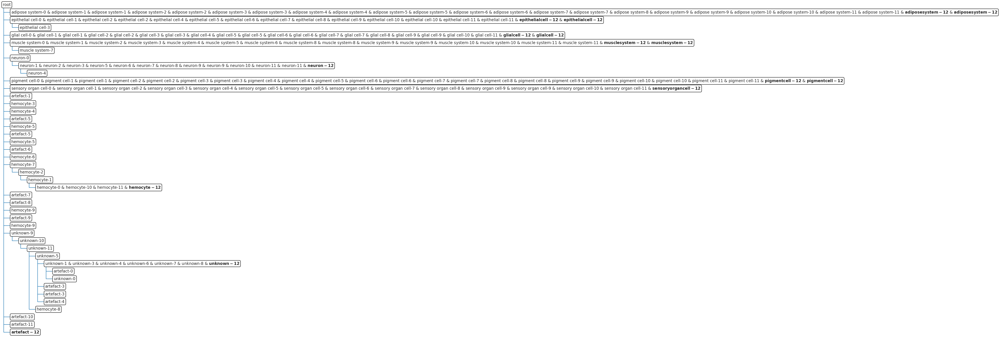

In [27]:
batchorder = reference_latent.obs.batch.unique().tolist()
tree_ref_broadannotation, mp_ref_broadannotation = sca.classifiers.scHPL.learn_tree(data = reference_latent,
                batch_key = 'batch',
                batch_order = batchorder ,
                cell_type_key='broad_annotation_batch',
                classifier = 'knn', dynamic_neighbors=True,
                dimred = False, print_conf= False)

Starting tree:


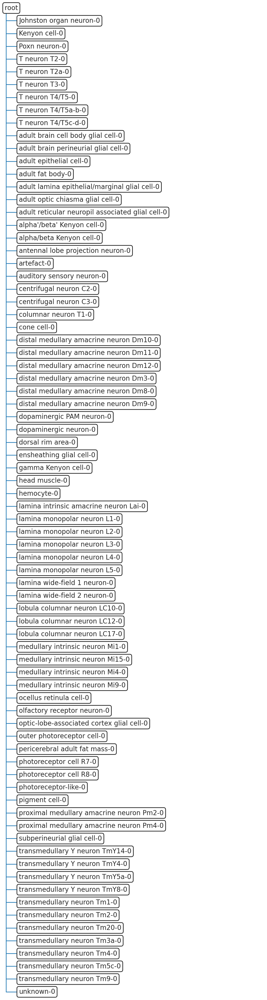


Adding dataset 1 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: M

These populations are missing from the tree: 
['Kenyon cell-1' 'Poxn neuron-1' 'T neuron T2a-1' 'T neuron T3-1'
 'T neuron T4/T5-1' 'adult optic chiasma glial cell-1'
 'antennal lobe projection neuron-1' 'artefact-1'
 'distal medullary amacrine neuron Dm12-1'
 'distal medullary amacrine neuron Dm3-1' 'dopaminergic PAM neuron-1'
 'dopaminergic neuron-1' 'dorsal rim area-1'
 'lamina intrinsic amacrine neuron Lai-1' 'lamina wide-field 1 neuron-1'
 'lobula columnar neuron LC10-1' 'lobula columnar neuron LC12-1'
 'lobula columnar neuron LC17-1' 'medullary intrinsic neuron Mi15-1'
 'medullary intrinsic neuron Mi9-1' 'octopaminergic/tyraminergic neuron-1'
 'perineurial glial sheath-1' 'photoreceptor cell R7-1'
 'photoreceptor cell R8-1' 'photoreceptor-like-1'
 'proximal medullary amacrine neuron Pm2-1'
 'proximal medullary amacrine neuron Pm4-1' 'subperineurial glial cell-1'
 'transmedullary Y neuron TmY14-1' 'transmedullary Y neuron TmY4-1'
 'transmedullary Y neuron TmY5a-1' 'transmedullary 

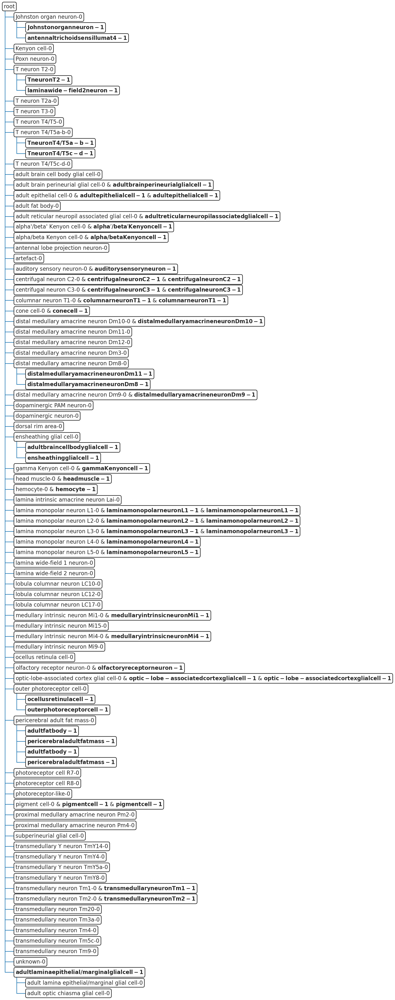


Adding dataset 2 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: M

These populations are missing from the tree: 
['Kenyon cell-2' 'Poxn neuron-2' 'T neuron T2a-2' 'T neuron T3-2'
 'T neuron T4/T5-2' 'T neuron T4/T5a-b-2' 'adult fat body-2'
 'adult optic chiasma glial cell-2' 'alpha/beta Kenyon cell-2'
 'antennal lobe projection neuron-2' 'artefact-2'
 'distal medullary amacrine neuron Dm12-2'
 'distal medullary amacrine neuron Dm3-2' 'dopaminergic PAM neuron-2'
 'dopaminergic neuron-2' 'dorsal rim area-2' 'gamma Kenyon cell-2'
 'lamina intrinsic amacrine neuron Lai-2' 'lamina wide-field 1 neuron-2'
 'lobula columnar neuron LC10-2' 'lobula columnar neuron LC12-2'
 'lobula columnar neuron LC17-2' 'medullary intrinsic neuron Mi15-2'
 'medullary intrinsic neuron Mi9-2' 'ocellus retinula cell-2'
 'octopaminergic/tyraminergic neuron-2' 'outer photoreceptor cell-2'
 'perineurial glial sheath-2' 'photoreceptor cell R7-2'
 'photoreceptor cell R8-2' 'photoreceptor-like-2'
 'proximal medullary amacrine neuron Pm2-2'
 'proximal medullary amacrine neuron Pm4-2' 's

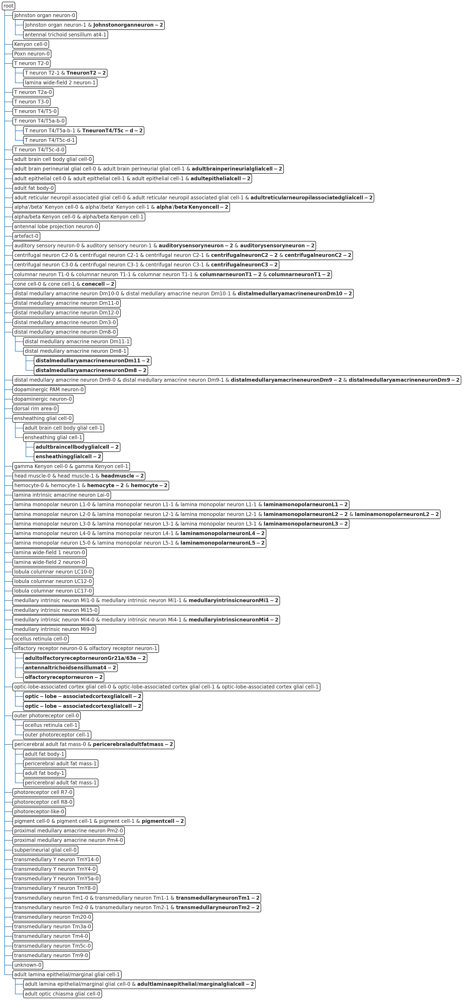


Adding dataset 3 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an it

These populations are missing from the tree: 
['Kenyon cell-3' 'Poxn neuron-3' 'T neuron T2a-3' 'T neuron T3-3'
 'T neuron T4/T5-3' 'adult brain cell body glial cell-3'
 'adult fat body-3' 'adult olfactory receptor neuron Gr21a/63a-3'
 'adult optic chiasma glial cell-3' 'alpha/beta Kenyon cell-3'
 'antennal lobe projection neuron-3' 'antennal trichoid sensillum at4-3'
 'artefact-3' 'distal medullary amacrine neuron Dm11-3'
 'distal medullary amacrine neuron Dm12-3'
 'distal medullary amacrine neuron Dm3-3'
 'distal medullary amacrine neuron Dm8-3' 'dopaminergic PAM neuron-3'
 'dopaminergic neuron-3' 'dorsal rim area-3' 'ensheathing glial cell-3'
 'lamina intrinsic amacrine neuron Lai-3' 'lamina wide-field 2 neuron-3'
 'lobula columnar neuron LC10-3' 'lobula columnar neuron LC12-3'
 'lobula columnar neuron LC17-3' 'medullary intrinsic neuron Mi15-3'
 'medullary intrinsic neuron Mi9-3' 'octopaminergic/tyraminergic neuron-3'
 'olfactory receptor neuron-3' 'optic-lobe-associated cortex gli

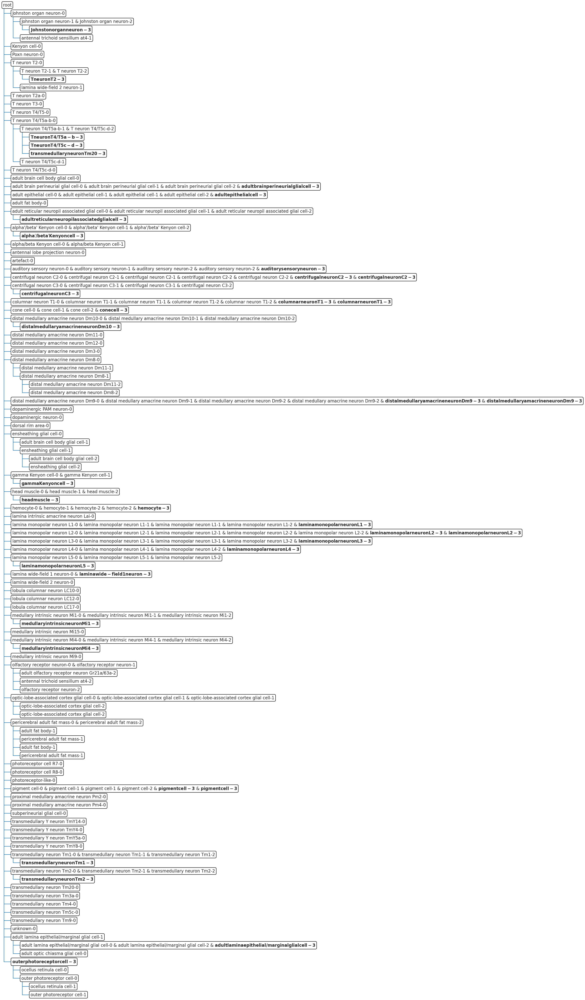


Adding dataset 4 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: M

These populations are missing from the tree: 
['Kenyon cell-4' 'Poxn neuron-4' 'T neuron T2-4' 'T neuron T2a-4'
 'T neuron T3-4' 'T neuron T4/T5-4' 'T neuron T4/T5a-b-4'
 'T neuron T4/T5c-d-4' 'adult brain cell body glial cell-4'
 'adult fat body-4' 'adult lobula astrocyte-like glial cell-4'
 'adult olfactory receptor neuron Gr21a/63a-4'
 'adult optic chiasma glial cell-4' 'antennal lobe projection neuron-4'
 'antennal trichoid sensillum at4-4' 'artefact-4'
 'distal medullary amacrine neuron Dm11-4'
 'distal medullary amacrine neuron Dm12-4'
 'distal medullary amacrine neuron Dm3-4'
 'distal medullary amacrine neuron Dm8-4' 'dopaminergic PAM neuron-4'
 'dopaminergic neuron-4' 'dorsal rim area-4' 'ensheathing glial cell-4'
 'lamina intrinsic amacrine neuron Lai-4' 'lamina wide-field 1 neuron-4'
 'lamina wide-field 2 neuron-4' 'lobula columnar neuron LC10-4'
 'lobula columnar neuron LC12-4' 'lobula columnar neuron LC17-4'
 'medullary intrinsic neuron Mi15-4' 'medullary intrinsic neuron M

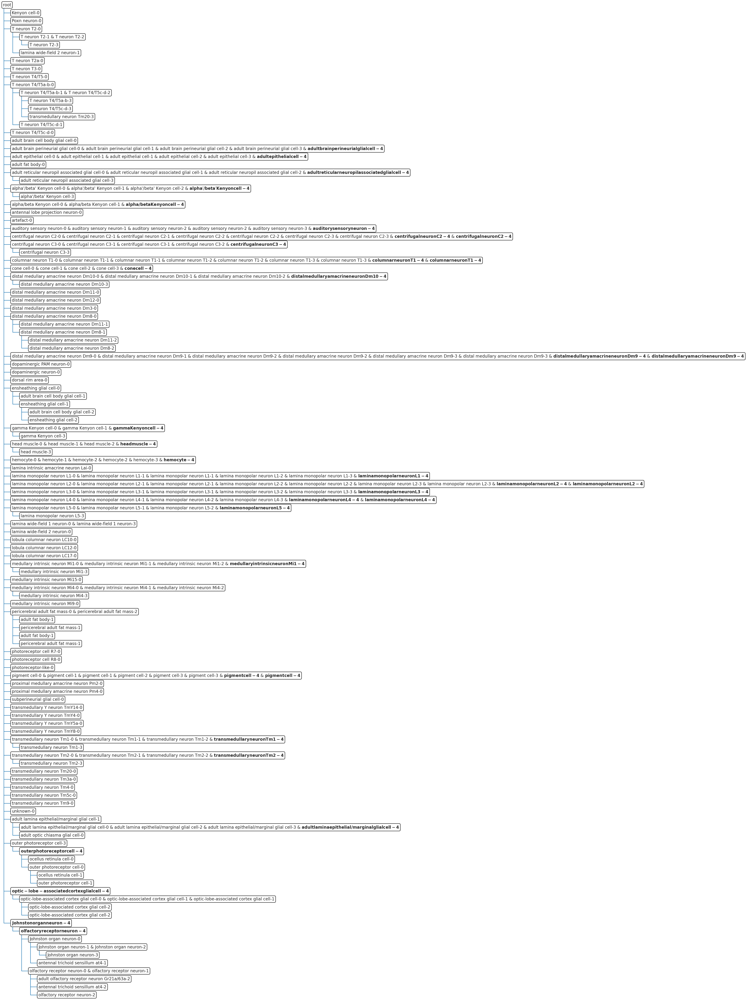


Adding dataset 5 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: M

These populations are missing from the tree: 
['Kenyon cell-5' 'Poxn neuron-5' 'T neuron T2-5' 'T neuron T2a-5'
 'T neuron T3-5' 'adult brain cell body glial cell-5' 'adult fat body-5'
 'adult olfactory receptor neuron Gr21a/63a-5'
 'adult optic chiasma glial cell-5' 'antennal lobe projection neuron-5'
 'antennal trichoid sensillum at4-5'
 'distal medullary amacrine neuron Dm11-5'
 'distal medullary amacrine neuron Dm12-5'
 'distal medullary amacrine neuron Dm3-5'
 'distal medullary amacrine neuron Dm8-5' 'dopaminergic PAM neuron-5'
 'dopaminergic neuron-5' 'dorsal rim area-5' 'ensheathing glial cell-5'
 'lamina intrinsic amacrine neuron Lai-5' 'lamina wide-field 2 neuron-5'
 'lobula columnar neuron LC10-5' 'lobula columnar neuron LC12-5'
 'lobula columnar neuron LC17-5' 'medullary intrinsic neuron Mi15-5'
 'medullary intrinsic neuron Mi9-5' 'octopaminergic/tyraminergic neuron-5'
 'olfactory receptor neuron-5' 'photoreceptor cell R7-5'
 'photoreceptor cell R8-5' 'photoreceptor-like-5'


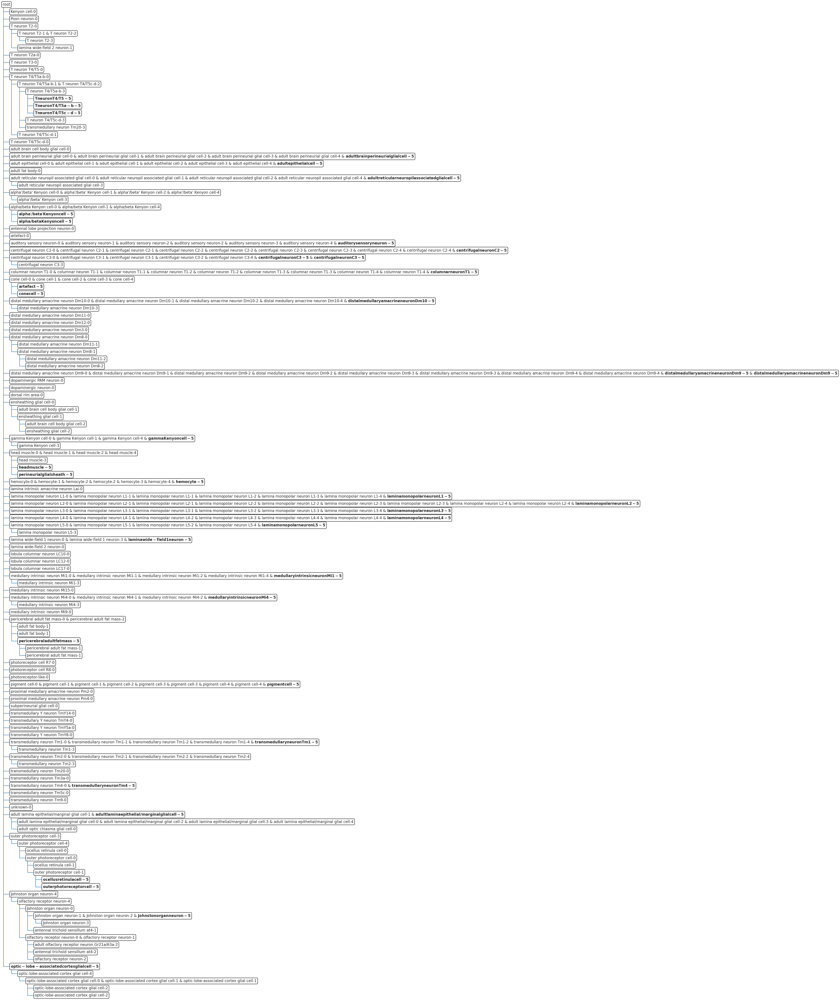


Adding dataset 6 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: M

These populations are missing from the tree: 
['Kenyon cell-6' 'T neuron T2-6' 'T neuron T3-6' 'T neuron T4/T5-6'
 'adult brain cell body glial cell-6' 'adult fat body-6'
 'adult optic chiasma glial cell-6' "alpha'/beta' Kenyon cell-6"
 'alpha/beta Kenyon cell-6' 'antennal lobe projection neuron-6'
 'artefact-6' 'distal medullary amacrine neuron Dm12-6'
 'distal medullary amacrine neuron Dm3-6' 'dopaminergic PAM neuron-6'
 'dopaminergic neuron-6' 'dorsal rim area-6' 'ensheathing glial cell-6'
 'gamma Kenyon cell-6' 'lamina wide-field 2 neuron-6'
 'lobula columnar neuron LC10-6' 'lobula columnar neuron LC12-6'
 'medullary intrinsic neuron Mi15-6' 'medullary intrinsic neuron Mi9-6'
 'optic-lobe-associated cortex glial cell-6'
 'pericerebral adult fat mass-6' 'photoreceptor-like-6'
 'proximal medullary amacrine neuron Pm2-6' 'subperineurial glial cell-6'
 'transmedullary Y neuron TmY14-6' 'transmedullary Y neuron TmY4-6'
 'transmedullary Y neuron TmY5a-6' 'transmedullary Y neuron TmY8-6'


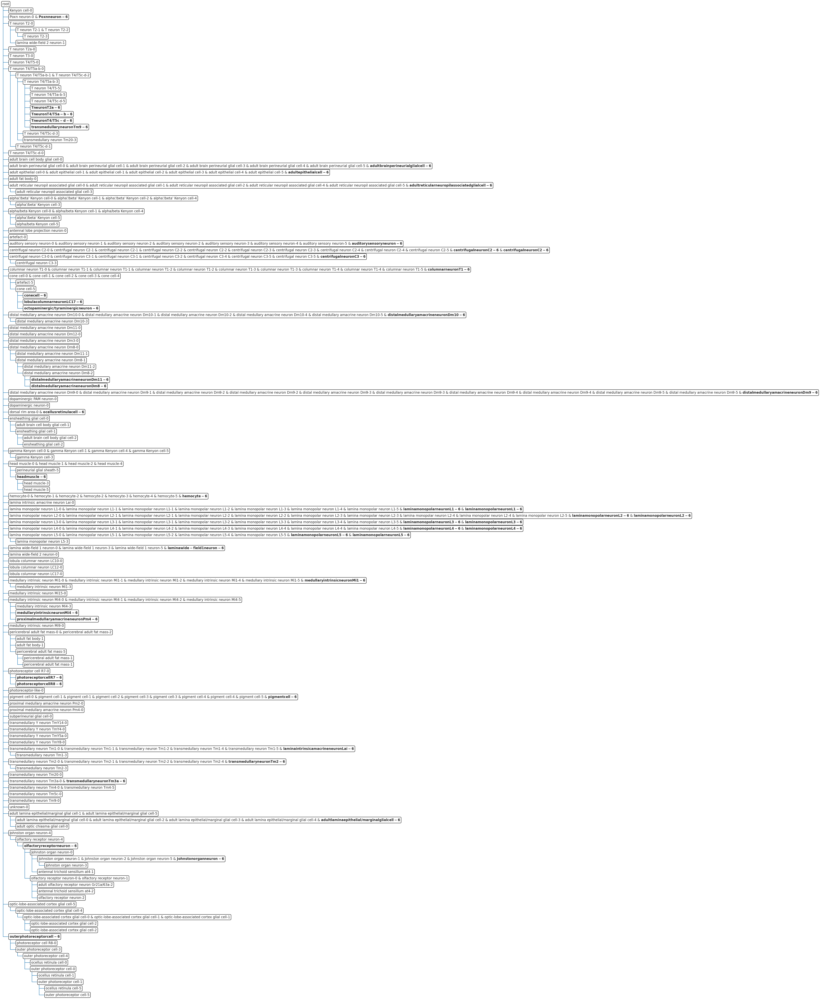


Adding dataset 7 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: M

These populations are missing from the tree: 
['Kenyon cell-7' 'T neuron T2a-7' 'T neuron T3-7'
 'adult brain cell body glial cell-7' 'adult epithelial cell-7'
 'adult fat body-7' 'antennal lobe projection neuron-7'
 'antennal trichoid sensillum at4-7'
 'distal medullary amacrine neuron Dm11-7'
 'distal medullary amacrine neuron Dm12-7'
 'distal medullary amacrine neuron Dm8-7' 'dopaminergic PAM neuron-7'
 'dopaminergic neuron-7' 'dorsal rim area-7' 'ensheathing glial cell-7'
 'lamina intrinsic amacrine neuron Lai-7' 'lamina wide-field 1 neuron-7'
 'lobula columnar neuron LC10-7' 'lobula columnar neuron LC12-7'
 'lobula columnar neuron LC17-7' 'medullary intrinsic neuron Mi15-7'
 'medullary intrinsic neuron Mi9-7' 'octopaminergic/tyraminergic neuron-7'
 'olfactory receptor neuron-7' 'photoreceptor cell R7-7'
 'photoreceptor cell R8-7' 'photoreceptor-like-7'
 'proximal medullary amacrine neuron Pm4-7' 'subperineurial glial cell-7'
 'transmedullary Y neuron TmY14-7' 'transmedullary Y neu

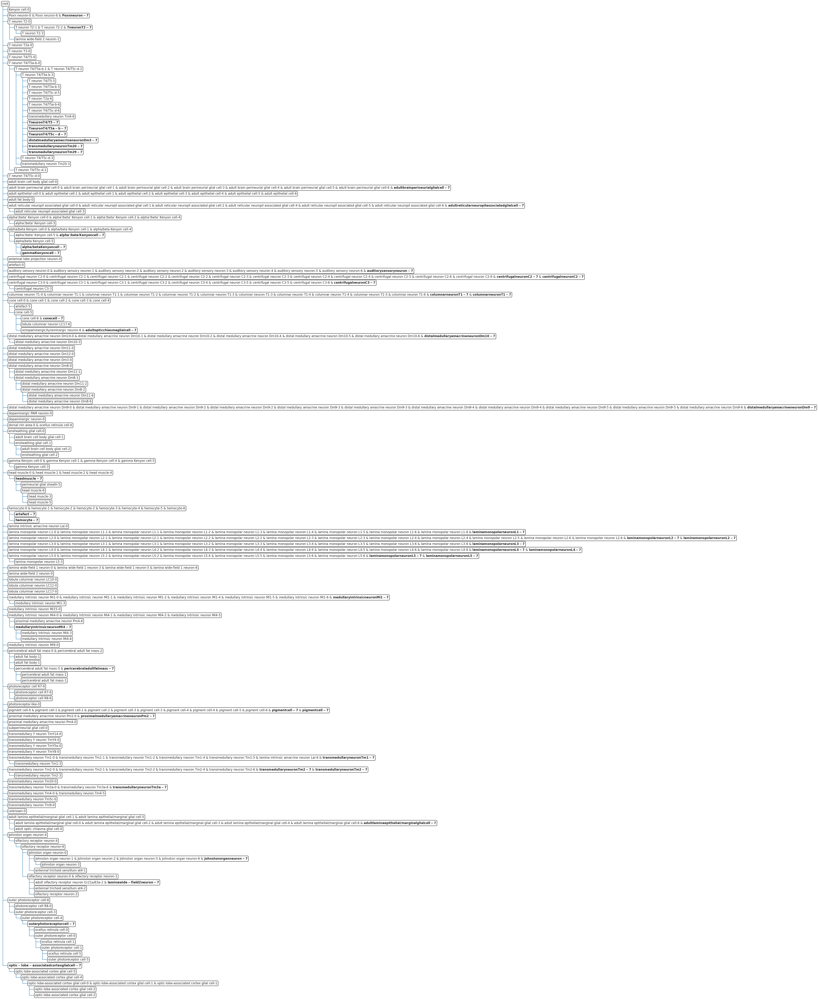


Adding dataset 8 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an it

These populations are missing from the tree: 
['Kenyon cell-8' 'T neuron T2a-8' 'T neuron T3-8' 'T neuron T4/T5-8'
 'adult brain cell body glial cell-8' 'adult epithelial cell-8'
 'adult fat body-8' 'adult optic chiasma glial cell-8'
 'antennal lobe projection neuron-8' 'antennal trichoid sensillum at4-8'
 'distal medullary amacrine neuron Dm11-8'
 'distal medullary amacrine neuron Dm12-8'
 'distal medullary amacrine neuron Dm3-8'
 'distal medullary amacrine neuron Dm8-8' 'dopaminergic PAM neuron-8'
 'dopaminergic neuron-8' 'gamma Kenyon cell-8' 'hemocyte-8'
 'lamina intrinsic amacrine neuron Lai-8' 'lobula columnar neuron LC12-8'
 'lobula columnar neuron LC17-8' 'medullary intrinsic neuron Mi15-8'
 'ocellus retinula cell-8' 'octopaminergic/tyraminergic neuron-8'
 'olfactory receptor neuron-8' 'outer photoreceptor cell-8'
 'pericerebral adult fat mass-8' 'photoreceptor-like-8'
 'proximal medullary amacrine neuron Pm2-8'
 'proximal medullary amacrine neuron Pm4-8' 'subperineurial glial 

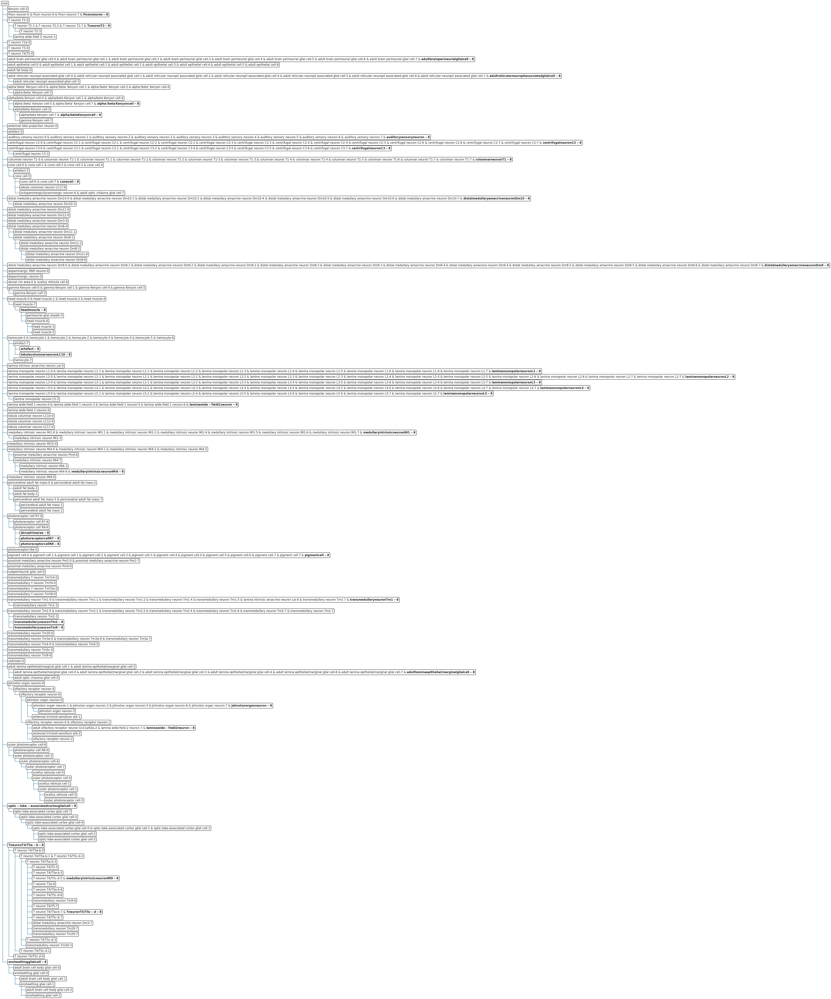


Adding dataset 9 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an it

These populations are missing from the tree: 
['Kenyon cell-9' 'Poxn neuron-9' 'T neuron T2a-9' 'T neuron T3-9'
 'T neuron T4/T5-9' 'T neuron T4/T5a-b-9'
 'adult brain cell body glial cell-9' 'adult optic chiasma glial cell-9'
 'antennal lobe projection neuron-9' 'antennal trichoid sensillum at4-9'
 'distal medullary amacrine neuron Dm12-9'
 'distal medullary amacrine neuron Dm8-9' 'dopaminergic PAM neuron-9'
 'dopaminergic neuron-9' 'ensheathing glial cell-9' 'gamma Kenyon cell-9'
 'lamina intrinsic amacrine neuron Lai-9' 'lobula columnar neuron LC10-9'
 'lobula columnar neuron LC12-9' 'lobula columnar neuron LC17-9'
 'medullary intrinsic neuron Mi15-9' 'medullary intrinsic neuron Mi9-9'
 'octopaminergic/tyraminergic neuron-9' 'olfactory receptor neuron-9'
 'photoreceptor-like-9' 'proximal medullary amacrine neuron Pm2-9'
 'proximal medullary amacrine neuron Pm4-9'
 'transmedullary Y neuron TmY14-9' 'transmedullary Y neuron TmY4-9'
 'transmedullary Y neuron TmY5a-9' 'transmedullary Y 


Adding dataset 10 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2' has dtype incompatible with bool, please explicitly cast to a compatible dtype first.
  BC.iloc[i, idxy] = 2
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an item of incompatible dtype is deprecated and will

These populations are missing from the tree: 
['Kenyon cell-10' 'T neuron T2a-10' 'T neuron T3-10' 'T neuron T4/T5-10'
 'adult epithelial cell-10' 'adult fat body-10'
 'adult optic chiasma glial cell-10' 'antennal lobe projection neuron-10'
 'distal medullary amacrine neuron Dm11-10'
 'distal medullary amacrine neuron Dm12-10'
 'distal medullary amacrine neuron Dm8-10' 'dopaminergic PAM neuron-10'
 'dopaminergic neuron-10' 'gamma Kenyon cell-10'
 'lamina intrinsic amacrine neuron Lai-10' 'lamina monopolar neuron L5-10'
 'lobula columnar neuron LC10-10' 'lobula columnar neuron LC12-10'
 'lobula columnar neuron LC17-10' 'medullary intrinsic neuron Mi15-10'
 'medullary intrinsic neuron Mi9-10'
 'octopaminergic/tyraminergic neuron-10' 'pericerebral adult fat mass-10'
 'photoreceptor cell R8-10' 'photoreceptor-like-10'
 'proximal medullary amacrine neuron Pm4-10'
 'subperineurial glial cell-10' 'transmedullary Y neuron TmY14-10'
 'transmedullary Y neuron TmY4-10' 'transmedullary Y neuron Tm


Adding dataset 11 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an it

These populations are missing from the tree: 
['Kenyon cell-11' 'T neuron T2-11' 'T neuron T2a-11' 'T neuron T3-11'
 'adult brain cell body glial cell-11' 'adult epithelial cell-11'
 'adult fat body-11' 'adult olfactory receptor neuron Gr21a/63a-11'
 'adult optic chiasma glial cell-11' 'alpha/beta Kenyon cell-11'
 'antennal lobe projection neuron-11' 'antennal trichoid sensillum at4-11'
 'distal medullary amacrine neuron Dm12-11'
 'distal medullary amacrine neuron Dm3-11' 'dopaminergic PAM neuron-11'
 'dopaminergic neuron-11' 'dorsal rim area-11' 'ensheathing glial cell-11'
 'gamma Kenyon cell-11' 'lamina intrinsic amacrine neuron Lai-11'
 'lamina wide-field 2 neuron-11' 'lobula columnar neuron LC10-11'
 'lobula columnar neuron LC12-11' 'lobula columnar neuron LC17-11'
 'medullary intrinsic neuron Mi15-11' 'ocellus retinula cell-11'
 'octopaminergic/tyraminergic neuron-11' 'olfactory receptor neuron-11'
 'outer photoreceptor cell-11' 'photoreceptor cell R7-11'
 'photoreceptor cell R8-1


Adding dataset 12 to the tree


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scHPL/update.py:140: FutureWarning: Setting an it

These populations are missing from the tree: 
['Poxn neuron-12' 'T neuron T2a-12' 'T neuron T3-12'
 'adult epithelial cell-12' 'adult fat body-12'
 'adult olfactory receptor neuron Gr21a/63a-12'
 'adult optic chiasma glial cell-12'
 'adult reticular neuropil associated glial cell-12'
 'antennal lobe projection neuron-12' 'artefact-12'
 'distal medullary amacrine neuron Dm11-12'
 'distal medullary amacrine neuron Dm12-12'
 'distal medullary amacrine neuron Dm8-12' 'dopaminergic PAM neuron-12'
 'dopaminergic neuron-12' 'dorsal rim area-12'
 'lamina intrinsic amacrine neuron Lai-12' 'lamina monopolar neuron L5-12'
 'lobula columnar neuron LC10-12' 'lobula columnar neuron LC12-12'
 'lobula columnar neuron LC17-12' 'medullary intrinsic neuron Mi15-12'
 'medullary intrinsic neuron Mi9-12' 'ocellus retinula cell-12'
 'outer photoreceptor cell-12' 'pericerebral adult fat mass-12'
 'photoreceptor cell R7-12' 'photoreceptor cell R8-12'
 'photoreceptor-like-12' 'proximal medullary amacrine neuron

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/sklearn/model_selection/_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


In [28]:
tree_ref_fullannotation, mp_ref_fullannotation = sca.classifiers.scHPL.learn_tree(data = reference_latent,
                batch_key = 'batch',
                batch_order = batchorder ,
                cell_type_key='annotation_batch',
                classifier = 'knn', dynamic_neighbors=True,
                dimred = False, print_conf= False)

In [29]:
commongenes = list(set(w1118_42d.var_names)& set(fca_reference.var_names))
print(len(commongenes))
w1118_42d = w1118_42d[:, fca_reference.var_names]
w1118_42d

1982


View of AnnData object with n_obs × n_vars = 9033 × 1982
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'cell_barcode', 'column_name', 'sample', 'sum', 'detected', 'percent.top_50', 'percent.top_100', 'percent.top_200', 'percent.top_500', 'total', 'doubletFinder_doublet_score_resolution_1.5', 'doubletFinder_doublet_label_resolution_1.5', 'scds_cxds_score', 'scds_cxds_call', 'scds_bcds_score', 'scds_bcds_call', 'scds_hybrid_score', 'scds_hybrid_call', 'decontX_contamination', 'decontX_clusters', 'nCount_decontXcounts', 'nFeature_decontXcounts', 'nCount_RNA', 'nFeature_RNA', 'log1p_total_counts', 'log1p_n_genes_by_counts', 'percent.mt', 'nCount_outlier', 'nFeature_outlier', 'mt_outlier', 'originalexp_snn_res.0.5', 'seurat_clusters', 'soup_group', 'nCount_soupXcounts', 'nFeature_soupXcounts', 'nCount_SCT', 'nFeature_SCT', 'nCount_soupX_SCT', 'nFeature_soupX_SCT', 'nCount_decontX_SCT', 'nFeature_decontX_SCT', 'SCT_snn_res.0.02', 'SCT_snn_res.0.2', 'SCT_snn_res.0.8', '

In [30]:
w1118_42d = w1118_42d.copy()

In [31]:
w1118_42d.obs['batch'] = "McCall_w1118_42d_batch1" ## all cells in the same batch

In [32]:
w1118_42d.obs[:5]

,orig.ident,nCount_originalexp,nFeature_originalexp,cell_barcode,column_name,sample,sum,detected,percent.top_50,percent.top_100,...,decontX_SCT_snn_res.0.2,decontX_SCT_snn_res.0.8,decontX_SCT_snn_res.1,decontX_SCT_snn_res.1.5,decontX_SCT_snn_res.2.5,decontX_SCT_snn_res.3.5,decontX_SCT_snn_res.4.5,decontX_SCT_snn_res.8,decontX_SCT_snn_res.12,batch
w1118_42D_AAACCCAAGAGAGCAA-1,0,823.0,444,AAACCCAAGAGAGCAA-1,w1118_42D_AAACCCAAGAGAGCAA-1,w1118_42D,823.0,444,36.938032,52.247874,...,11,15,16,16,20,24,25,19,33,McCall_w1118_42d_batch1
w1118_42D_AAACCCAAGCCGGATA-1,0,1138.0,686,AAACCCAAGCCGGATA-1,w1118_42D_AAACCCAAGCCGGATA-1,w1118_42D,1138.0,686,25.834798,38.664323,...,0,0,3,2,7,3,3,0,39,McCall_w1118_42d_batch1
w1118_42D_AAACCCACATAATGCC-1,0,1573.0,809,AAACCCACATAATGCC-1,w1118_42D_AAACCCACATAATGCC-1,w1118_42D,1573.0,809,25.874126,38.270820,...,7,10,10,10,10,9,26,27,9,McCall_w1118_42d_batch1
w1118_42D_AAACCCAGTACTCAAC-1,0,2398.0,799,AAACCCAGTACTCAAC-1,w1118_42D_AAACCCAGTACTCAAC-1,w1118_42D,2398.0,799,47.122602,57.714762,...,2,6,5,7,5,14,9,41,29,McCall_w1118_42d_batch1
w1118_42D_AAACCCATCAAGGCTT-1,0,693.0,427,AAACCCATCAAGGCTT-1,w1118_42D_AAACCCATCAAGGCTT-1,w1118_42D,693.0,427,35.209235,49.639250,...,6,9,9,12,19,23,23,37,35,McCall_w1118_42d_batch1


In [33]:

ref_path = "/projectnb/mccall/sbandyadka/drpr42d_snrnaseq/analysis/scarches/"
model = sca.models.SCVI.load_query_data(
    w1118_42d,
    ref_path ,
    freeze_dropout = True,
)

INFO     File /projectnb/mccall/sbandyadka/drpr42d_snrnaseq/analysis/scarches/model.pt already downloaded          


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [34]:
model.train(max_epochs=50)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Epoch 1/50:   0%|          | 0/50 [00:00<?, ?it/s]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/50:   2%|▏         | 1/50 [00:00<00:37,  1.29it/s, v_num=1, train_loss_step=380, train_loss_epoch=400]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/50:   4%|▍         | 2/50 [00:01<00:36,  1.31it/s, v_num=1, train_loss_step=402, train_loss_epoch=398]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/50:   6%|▌         | 3/50 [00:02<00:35,  1.32it/s, v_num=1, train_loss_step=403, train_loss_epoch=397]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/50:   8%|▊         | 4/50 [00:03<00:35,  1.31it/s, v_num=1, train_loss_step=387, train_loss_epoch=396]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/50:  10%|█         | 5/50 [00:03<00:34,  1.31it/s, v_num=1, train_loss_step=395, train_loss_epoch=395]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/50:  12%|█▏        | 6/50 [00:04<00:33,  1.31it/s, v_num=1, train_loss_step=388, train_loss_epoch=395]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/50:  14%|█▍        | 7/50 [00:05<00:32,  1.31it/s, v_num=1, train_loss_step=417, train_loss_epoch=395]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/50:  16%|█▌        | 8/50 [00:06<00:31,  1.32it/s, v_num=1, train_loss_step=404, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/50:  18%|█▊        | 9/50 [00:06<00:31,  1.32it/s, v_num=1, train_loss_step=406, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/50:  20%|██        | 10/50 [00:07<00:30,  1.32it/s, v_num=1, train_loss_step=373, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/50:  22%|██▏       | 11/50 [00:08<00:29,  1.32it/s, v_num=1, train_loss_step=405, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/50:  24%|██▍       | 12/50 [00:09<00:28,  1.32it/s, v_num=1, train_loss_step=376, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/50:  26%|██▌       | 13/50 [00:09<00:28,  1.32it/s, v_num=1, train_loss_step=396, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/50:  28%|██▊       | 14/50 [00:10<00:27,  1.32it/s, v_num=1, train_loss_step=403, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/50:  30%|███       | 15/50 [00:11<00:26,  1.32it/s, v_num=1, train_loss_step=394, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/50:  32%|███▏      | 16/50 [00:12<00:25,  1.32it/s, v_num=1, train_loss_step=406, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/50:  34%|███▍      | 17/50 [00:12<00:25,  1.32it/s, v_num=1, train_loss_step=404, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/50:  36%|███▌      | 18/50 [00:13<00:24,  1.31it/s, v_num=1, train_loss_step=380, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/50:  38%|███▊      | 19/50 [00:14<00:23,  1.31it/s, v_num=1, train_loss_step=394, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/50:  40%|████      | 20/50 [00:15<00:22,  1.31it/s, v_num=1, train_loss_step=398, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/50:  42%|████▏     | 21/50 [00:15<00:22,  1.32it/s, v_num=1, train_loss_step=400, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/50:  44%|████▍     | 22/50 [00:16<00:21,  1.32it/s, v_num=1, train_loss_step=407, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/50:  46%|████▌     | 23/50 [00:17<00:20,  1.32it/s, v_num=1, train_loss_step=400, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/50:  48%|████▊     | 24/50 [00:18<00:19,  1.31it/s, v_num=1, train_loss_step=387, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/50:  50%|█████     | 25/50 [00:19<00:19,  1.32it/s, v_num=1, train_loss_step=408, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/50:  52%|█████▏    | 26/50 [00:19<00:18,  1.32it/s, v_num=1, train_loss_step=395, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/50:  54%|█████▍    | 27/50 [00:20<00:17,  1.32it/s, v_num=1, train_loss_step=400, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/50:  56%|█████▌    | 28/50 [00:21<00:16,  1.32it/s, v_num=1, train_loss_step=392, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/50:  58%|█████▊    | 29/50 [00:22<00:15,  1.32it/s, v_num=1, train_loss_step=388, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/50:  60%|██████    | 30/50 [00:22<00:15,  1.32it/s, v_num=1, train_loss_step=402, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/50:  62%|██████▏   | 31/50 [00:23<00:14,  1.32it/s, v_num=1, train_loss_step=389, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/50:  64%|██████▍   | 32/50 [00:24<00:13,  1.32it/s, v_num=1, train_loss_step=394, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 34/50:  66%|██████▌   | 33/50 [00:25<00:12,  1.32it/s, v_num=1, train_loss_step=409, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 35/50:  68%|██████▊   | 34/50 [00:25<00:12,  1.32it/s, v_num=1, train_loss_step=403, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 36/50:  70%|███████   | 35/50 [00:26<00:11,  1.32it/s, v_num=1, train_loss_step=401, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 37/50:  72%|███████▏  | 36/50 [00:27<00:10,  1.32it/s, v_num=1, train_loss_step=391, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 38/50:  74%|███████▍  | 37/50 [00:28<00:09,  1.32it/s, v_num=1, train_loss_step=388, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 39/50:  76%|███████▌  | 38/50 [00:28<00:09,  1.32it/s, v_num=1, train_loss_step=383, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 40/50:  78%|███████▊  | 39/50 [00:29<00:08,  1.32it/s, v_num=1, train_loss_step=397, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 41/50:  80%|████████  | 40/50 [00:30<00:07,  1.32it/s, v_num=1, train_loss_step=396, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 42/50:  82%|████████▏ | 41/50 [00:31<00:06,  1.32it/s, v_num=1, train_loss_step=386, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 43/50:  84%|████████▍ | 42/50 [00:31<00:06,  1.31it/s, v_num=1, train_loss_step=387, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 44/50:  86%|████████▌ | 43/50 [00:32<00:05,  1.32it/s, v_num=1, train_loss_step=377, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 45/50:  88%|████████▊ | 44/50 [00:33<00:04,  1.32it/s, v_num=1, train_loss_step=385, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 46/50:  90%|█████████ | 45/50 [00:34<00:03,  1.32it/s, v_num=1, train_loss_step=394, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 47/50:  92%|█████████▏| 46/50 [00:34<00:03,  1.32it/s, v_num=1, train_loss_step=382, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 48/50:  94%|█████████▍| 47/50 [00:35<00:02,  1.32it/s, v_num=1, train_loss_step=397, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 49/50:  96%|█████████▌| 48/50 [00:36<00:01,  1.32it/s, v_num=1, train_loss_step=407, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/50:  98%|█████████▊| 49/50 [00:37<00:00,  1.31it/s, v_num=1, train_loss_step=404, train_loss_epoch=394]

/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/module/_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/50: 100%|██████████| 50/50 [00:37<00:00,  1.31it/s, v_num=1, train_loss_step=411, train_loss_epoch=394]

`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|██████████| 50/50 [00:37<00:00,  1.32it/s, v_num=1, train_loss_step=411, train_loss_epoch=394]


In [35]:
query_latent = sc.AnnData(model.get_latent_representation())
#query_latent.obs['cell_type'] = target_adata.obs["final_annotation"].tolist()
query_latent.obs['batch'] = w1118_42d.obs["batch"].tolist()

In [36]:
model.save(outputpath, overwrite=True)
query_latent.write('query_latent.h5ad')

In [37]:
adata_full = fca_reference.concatenate(w1118_42d, batch_key="ref_query")
adata_full

/scratch/6027565.1.onrcc-gpu-pub/ipykernel_3544346/2877884795.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_full = fca_reference.concatenate(w1118_42d, batch_key="ref_query")


AnnData object with n_obs × n_vars = 109560 × 1982
    obs: 'age', 'batch', 'batch_id', 'celda_decontx__clusters', 'celda_decontx__contamination', 'celda_decontx__doublemad_predicted_outliers', 'dissection_lab', 'fca_id', 'fly_genetics', 'id', 'log_n_counts', 'log_n_genes', 'n_counts', 'n_genes', 'note', 'percent_mito', 'sample_id', 'scrublet__doublet_scores', 'scrublet__predicted_doublets', 'scrublet__predicted_doublets_based_on_10x_chromium_spec', 'sex', 'tissue', 'leiden_res0.4', 'leiden_res0.6', 'leiden_res0.8', 'leiden_res1.0', 'leiden_res1.2', 'leiden_res1.4', 'leiden_res1.6', 'leiden_res1.8', 'leiden_res10.0', 'leiden_res12.0', 'leiden_res14.0', 'leiden_res16.0', 'leiden_res18.0', 'leiden_res2.0', 'leiden_res20.0', 'leiden_res25.0', 'leiden_res4.0', 'leiden_res50.0', 'leiden_res6.0', 'leiden_res8.0', 'annotation', 'broad_annotation', 'broad_annotation_extrapolated', '_scvi_batch', '_scvi_labels', 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'cell_barcode', 'column

In [38]:
full_latent = sc.AnnData(model.get_latent_representation(adata=adata_full))
full_latent.obs['annotation'] = adata_full.obs["annotation"].tolist()
full_latent.obs["broad_annotation"] = adata_full.obs["broad_annotation"].tolist()
full_latent.obs["broad_annotation_extrapolated"] = adata_full.obs["broad_annotation_extrapolated"].tolist()
full_latent.obs['batch'] = adata_full.obs["batch"].tolist()

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             


/projectnb/mccall/sbandya/.conda/envs/drpr_snrnaseq_gpu/lib/python3.12/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [39]:
sc.pp.neighbors(full_latent)
sc.tl.leiden(full_latent)
sc.tl.umap(full_latent)

computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)
running Leiden clustering
    finished: found 26 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:28)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:07)


In [40]:
full_latent

AnnData object with n_obs × n_vars = 109560 × 10
    obs: 'annotation', 'broad_annotation', 'broad_annotation_extrapolated', 'batch', 'leiden'
    uns: 'neighbors', 'leiden', 'umap'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

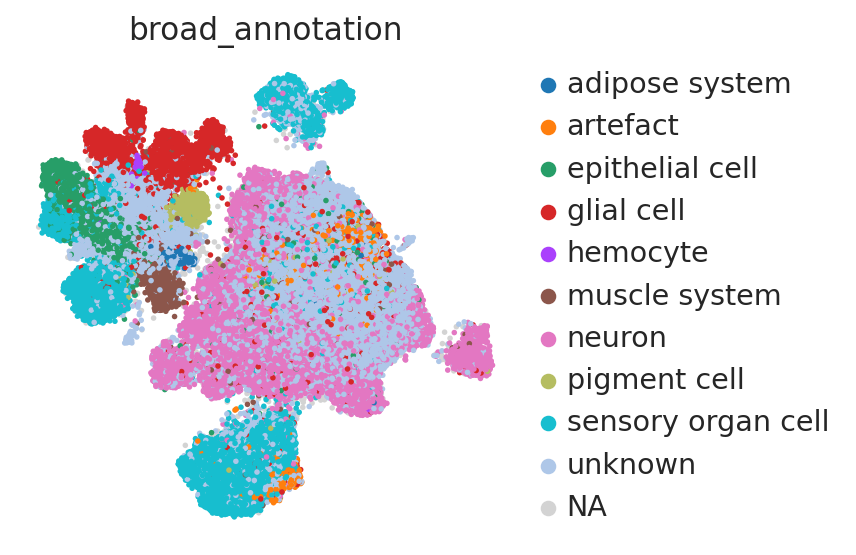

In [41]:
sc.pl.umap(full_latent,
           color=['broad_annotation'],
           frameon=False,
           wspace=0.6, s=25,
           #palette=sns.color_palette('colorblind', as_cmap=True)[:5],
           #save='study_query.pdf'
           )

In [42]:
query_pred_fullannotation = sca.classifiers.scHPL.predict_labels(query_latent.X, tree=tree_ref_fullannotation)
query_pred_braodannotation = sca.classifiers.scHPL.predict_labels(query_latent.X, tree=tree_ref_broadannotation)

In [43]:
w1118_42d.obs['predicted_fullannotation'] = query_pred_fullannotation[0]
w1118_42d.obs['predicted_broadannotation'] = query_pred_braodannotation[0]

In [44]:
sc.pp.neighbors(w1118_42d)
sc.tl.leiden(w1118_42d)
sc.tl.umap(w1118_42d)


computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)


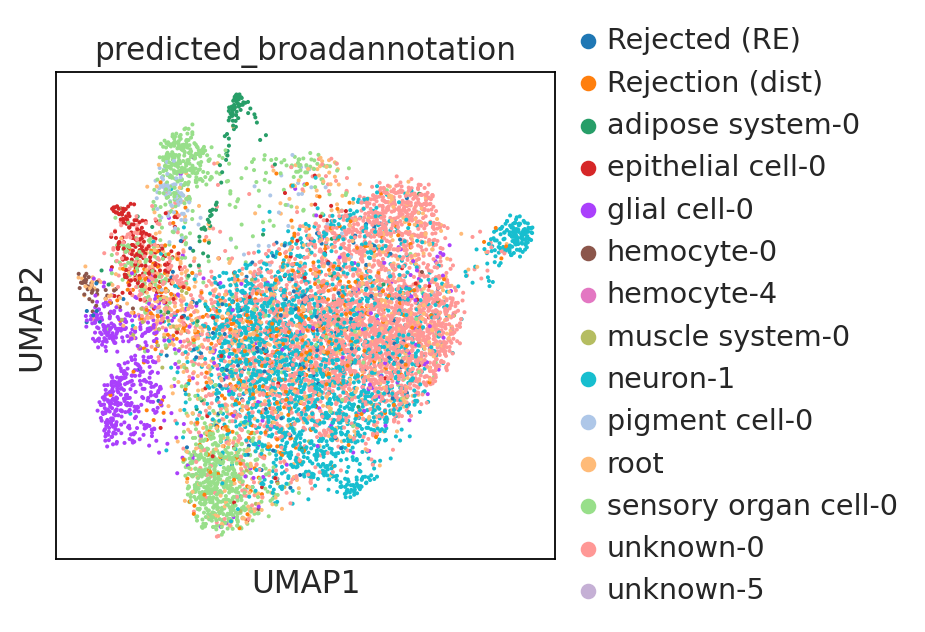

In [45]:
sc.pl.umap(w1118_42d,color=['predicted_broadannotation'])

the obs value 'predicted_fullannotation' has more than 103 categories. Uniform 'grey' color will be used for all categories.


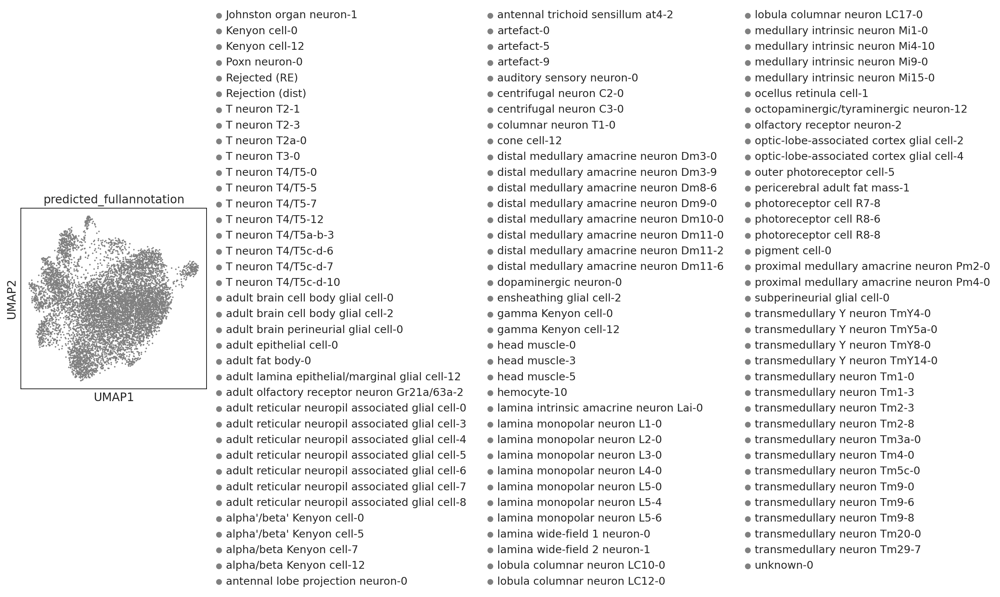

In [46]:
sc.pl.umap(w1118_42d,color=['predicted_fullannotation'])

In [47]:
markers = ["elav","lncRNA:noe","VAChT","VGlut","Gad1","Vmat","SerT","Tdc2","ple", # neurons
             "repo","lncRNA:CR34335","alrm","wrapper","Indy","moody",#glia 
             "ninaC",	"trp",	"trpl", #photoreceptors
             "Hml", #hemocytes
             "ppl",#fatbody
             "drpr"]


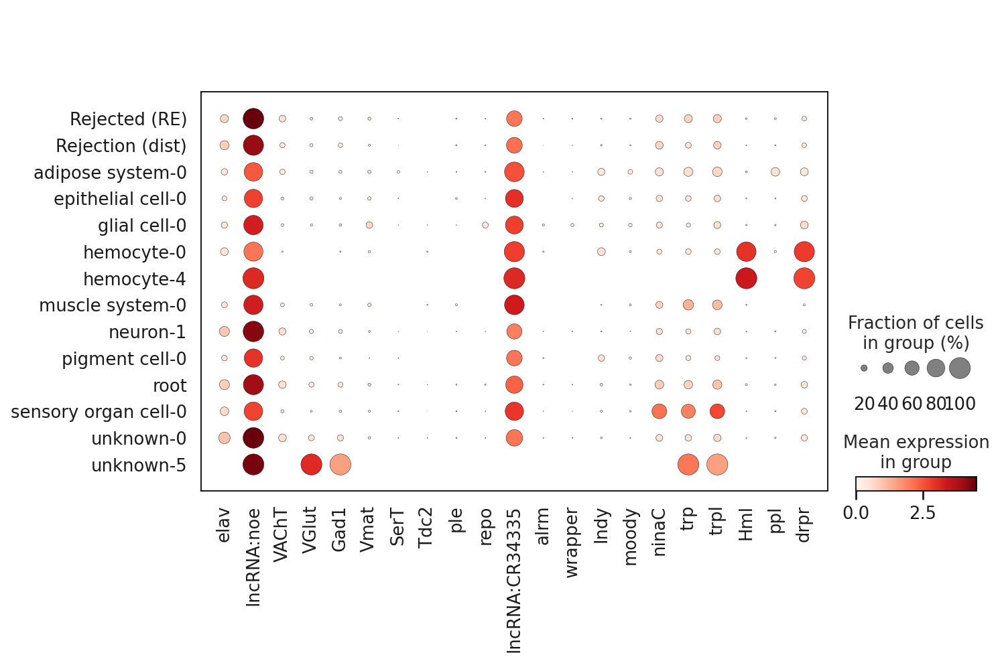

In [48]:
sc.pl.dotplot(w1118_42d, markers, 'predicted_broadannotation')

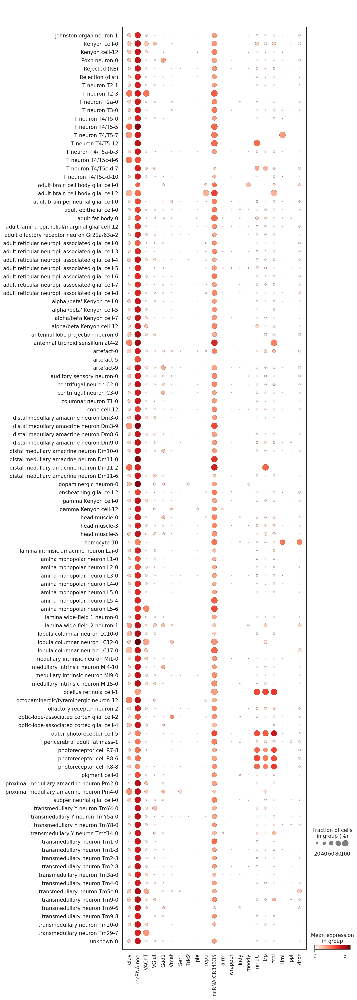

In [49]:
sc.pl.dotplot(w1118_42d, markers, 'predicted_fullannotation')